In [1]:
%load_ext autoreload
%autoreload 2
    
import glob, os, sys
import shutil
import numpy as np
import matplotlib.pyplot as plt
import torch

pathsave = "/plp_user/agar_sh/gaia-git/python/modules/"
sys.path.insert(0, pathsave)
from gaia import *
import pickle
from matplotlib.animation import FuncAnimation
from matplotlib import cm, ticker

pathsave = "/plp_user/agar_sh/gaia-git/python/modules/"
sys.path.insert(0, pathsave)
from gaia import *
from decimal import Decimal
from itertools import product

from scipy.stats import pearsonr


In [2]:
data_dir = "/plp_scr1/agar_sh/data/TPH/"

In [3]:

sims = torch.load(data_dir + "/sims.pt")
paras = []
for i in [120,122,119]:
    paras.append([sims[i][2], sims[i][3], sims[i][4]])

paras += [[0, 1e+6, 1],
          [10, 1e+10, 100], 
          [0, 1e+6*0.8, 1],
          [10*1.1, 1e+10*1.1, 100*1.1]
         ]

for p in paras:
    print(p[0], ",",  "{:.5E}".format(Decimal(p[1])), ",", "{:.5E}".format(Decimal(p[2])))

0.80523448 , 3.29628E+6 , 6.37660E+0
9.17743012 , 1.79784E+8 , 7.49928E+0
8.75081696 , 1.68605E+9 , 2.88237E+1
0 , 1.00000E+6 , 1.00000E+0
10 , 1.00000E+10 , 1.00000E+2
0 , 8.00000E+5 , 1.00000E+0
11.0 , 1.10000E+10 , 1.10000E+2


/tmp/ipykernel_2774152/24128583.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  sims = torch.load(data_dir + "/sims.pt")


In [4]:
combs =   [
            # raq,fkt,fkp, network, padding, kernel, symmetry, layers, p_pred, filters, "loss", batch size, levels, advect, loss_scale, loss_de, l2, 
            # mode, mmskip, start, urf, solver, Di, write, cool, decay, gpu

            # speedup test
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  1, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA", 1,  "hot", 0.99, "iterative", 0.0, 1000, 0, 0, 0],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  100, "hot", 1.0,  "mumps", 0.0, 100, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 1],
    
            # parameter tests
            [0.80523448 , 3.29628E+6 , 6.37660E+0] + [" "]*14 + ["GAIA",  1, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [9.17743012 , 1.79784E+8 , 7.49928E+0] + [" "]*14 + ["GAIA",  1, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [0 , 1.00E+6 , 1.0000E+0]          + [" "]*14 + ["GAIA",  1, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [10 , 1.00E+10 , 1.0000E+2]        + [" "]*14 + ["GAIA",  1, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [0.80523448 , 3.29628E+6 , 6.37660E+0] + [" "]*14 + ["GAIA",  100, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [9.17743012 , 1.79784E+8 , 7.49928E+0] + [" "]*14 + ["GAIA",  100, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [0 , 1.00E+6 , 1.0000E+0]          + [" "]*14 + ["GAIA",  100, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [10 , 1.00E+10 , 1.0000E+2]        + [" "]*14 + ["GAIA",  100, "hot", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [0.80523448 , 3.29628E+6 , 6.37660E+0] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 1],
            [9.17743012 , 1.79784E+8 , 7.49928E+0] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 2],
            [0 , 1.00E+6 , 1.0000E+0]          + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 4],
            [10 , 1.00E+10 , 1.0000E+2]        + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 5],
            
            # EBA tests
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  1,  "hot", 1.0,  "mumps", 0.1, 1000, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  1,  "hot", 0.99,  "iterative", 0.1, 1000, 0, 0, 0],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  100,  "hot", 1.0,  "mumps", 0.1, 100, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9),  "hot",  1.0,  "mumps", 0.1, 100, 0, 0, 1],

            # different starts
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  1, "cold",    1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  1, "linear",  1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  1, "perfect", 1.0, "mumps", 0.0, 1000, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  100, "cold",    1.0, "mumps", 0.0, 100, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  100, "linear",  1.0, "mumps", 0.0, 100, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  100, "perfect", 1.0, "mumps", 0.0, 100, 0, 0, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9),  "cold",    1.0,  "mumps", 0.0, 100, 0, 0, 3],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9),  "linear",  1.0,  "mumps", 0.0, 100, 0, 0, 4],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9),  "perfect", 1.0,  "mumps", 0.0, 100, 0, 0, 5],

            # radioactive decay test
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  1, "hot", 1.0, "mumps", 0.0, 1000, 0, 1, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + [" "]*14 + ["GAIA",  100, "hot", 1.0, "mumps", 0.0, 100, 0, 1, -1],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 1, 0],

            
            # ablations
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "mass", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 2],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "replicate", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 2],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 0, 0, 0.0,   # loss scale
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 2],    
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "zeros", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, # padding 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 0],
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "zeros", 5, 0, 4, 0, 64, "curl", 8, 5, 0, 1, 1, 0.0, # padding spc
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 0],
            # to run
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 0, 1, 0.0,   # loss scale - de
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 0],  
            # to run
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["newfluidnet", "learned", 5, 0, 6, 0, 16, "curl", 16, 5, 0, 1, 0, 0.0,   # no loss scale + de
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 1],  

            # unets # to run
            # to run
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["unet", "zeros", 5, 0, 3, 0, 16, "curl", 16, 5, 0, 0, 0, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 2], #spc
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["unet", "zeros", 5, 0, 3, 0, 64, "curl", 16, 5, 0, 0, 0, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 3], #sit
            
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["unet", "learned", 5, 0, 3, 0, 6, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 4], #spc+tricks
            [8.75081696 , 1.68605E+9 , 2.88237E+1] + ["unet", "learned", 5, 0, 3, 0, 16, "curl", 16, 5, 0, 1, 1, 0.0, 
                                                  "ML_STOKES", int(1e+9), "hot", 1.0, "mumps", 0.0, 100, 0, 0, 5], #sit+tricks
            
            ]

cntr = 0

for comb in combs:
    raq, fkt, fkp, net, pad, ker, sym, rep, p_pred, fil, loss_type, \
    b, levels, advect, loss_scale, loss_derivative, l2, mode, i, start, urf, solver, \
    Di, write, cool, decay, gpu_num = comb

    if raq<1:
        t = "1.0" 
    elif raq>5:
        t = "0.1"
    else:
        t = "0.2"

    if mode == "GAIA":
         suff = " -w 2 -save 200 -write " + str(write) + " -i " + str(i) + " -init " + start + " -u " + str(urf) \
              + " -sol " + solver + " -di " + str(Di) + " -cool " + str(cool) + " -decay " + str(decay) + " >out_" + str(cntr) + ".txt &;"
    else:
         suff = " -w 2 -i " + str(i) + " -init " + start + " -u " + str(urf) \
              + " -sol " + solver + " -di " + str(Di) + " -gpu " + str(gpu_num) + " -f " + str(fil) + " -s " + str(sym) + " -r " \
              + str(rep) + " -k " + str(ker) + " -lt " + loss_type + " -pp " + str(p_pred) + " -ad 2 " \
              + " -b " + str(b) + " -l " + str(levels) + " -ad_loss " + str(advect) + " -l_sc " + str(loss_scale)  + " -l_de " + str(loss_derivative) \
              + " -l2 "  + str(l2) + " -save 200 -write " + str(write) + " -net " + str(net) + " -pad " + str(pad) \
              + " -cool " + str(cool) + " -decay " + str(decay) \
              + " -e -1 " + " >out_" + str(cntr) + ".txt &;"

    if i>1 and mode=="GAIA":
        print("python advect_wi_gaia.py -t " + t + " -m " + mode + " -raq " + str(raq) + " -fkt " + str(fkt) + " -fkp " + str(fkp) + suff)

    cntr += 1
    #print()

python advect_wi_gaia.py -t 0.1 -m GAIA -raq 8.75081696 -fkt 1686050000.0 -fkp 28.8237 -w 2 -save 200 -write 100 -i 100 -init hot -u 1.0 -sol mumps -di 0.0 -cool 0 -decay 0 >out_2.txt &;
python advect_wi_gaia.py -t 1.0 -m GAIA -raq 0.80523448 -fkt 3296280.0 -fkp 6.3766 -w 2 -save 200 -write 1000 -i 100 -init hot -u 1.0 -sol mumps -di 0.0 -cool 0 -decay 0 >out_8.txt &;
python advect_wi_gaia.py -t 0.1 -m GAIA -raq 9.17743012 -fkt 179784000.0 -fkp 7.49928 -w 2 -save 200 -write 1000 -i 100 -init hot -u 1.0 -sol mumps -di 0.0 -cool 0 -decay 0 >out_9.txt &;
python advect_wi_gaia.py -t 1.0 -m GAIA -raq 0 -fkt 1000000.0 -fkp 1.0 -w 2 -save 200 -write 1000 -i 100 -init hot -u 1.0 -sol mumps -di 0.0 -cool 0 -decay 0 >out_10.txt &;
python advect_wi_gaia.py -t 0.1 -m GAIA -raq 10 -fkt 10000000000.0 -fkp 100.0 -w 2 -save 200 -write 1000 -i 100 -init hot -u 1.0 -sol mumps -di 0.0 -cool 0 -decay 0 >out_11.txt &;
python advect_wi_gaia.py -t 0.1 -m GAIA -raq 8.75081696 -fkt 1686050000.0 -fkp 28.8237 -w

In [5]:
def get_data(raq, fkt, fkp, mmskip, solver, urf, Di, start, mode, core_cool, radioactive_decay, 
             r_p="learned", loss_type="curl", loss_scale=True, loss_derivative=True,
             architecture=["newfluidnet", 5, 0, 6, 0, 16, 16, 5, 0, 0.0]):

    if r_p == "zeros64":
        architecture = ["newfluidnet", 5, 0, 4, 0, 64, 8, 5, 0, 0.0]
        r_p = "zeros"
    elif r_p == "u_spc_t":
        architecture = ["unet", 5, 0, 3, 0, 6, 16, 5, 0, 0.0]
        r_p = "learned"
        loss_scale = True
        loss_derivative = True
    elif r_p == "u_sit_t":
        architecture = ["unet", 5, 0, 3, 0, 16, 16, 5, 0, 0.0]
        r_p = "learned"
        loss_scale = True
        loss_derivative = True
    elif r_p == "u_spc":
        architecture = ["unet", 5, 0, 3, 0, 16, 16, 5, 0, 0.0]
        r_p = "zeros"
        loss_scale = False
        loss_derivative = False
    elif r_p == "u_sit":
        architecture = ["unet", 5, 0, 3, 0, 64, 16, 5, 0, 0.0]
        r_p = "zeros"
        loss_scale = False
        loss_derivative = False

    net, ker, sym, rep, p_pred, fil, b, levels, advect, l2 = architecture
    p_pred = True if p_pred == 1 else False
    sym = True if sym == 1 else False
    advect = True if advect == 1 else False
    
    if mode == "GAIA":
        simulation = "raq_" + str(raq) + "_fkt_" + str(fkt) + "_fkv_" + str(fkp) + "_mmskip" + str(mmskip
      ) + "_sol" + solver + "_urf" + str(urf) + "_Di" + str(Di) + "_start" + start
    else:
        simulation = net + "_raq_" + str(raq) + "_fkt_" + str(fkt) + "_fkv_" + str(fkp) + "_f" + str(
         fil) + "_symm" + str(sym) + "_r" + str(rep) + "_k" + str(
         ker) + "_p" + str(p_pred) + "_l" + loss_type + "_b" + str(b) +\
        "_ad" + str(False) + "_lev" + str(levels) + "_l_sc" + str(loss_scale) + "_l_de" + str(loss_derivative) +\
        "_l2_" + str(l2) + "_r_p" + r_p + "_Di" + str(Di) + "_start" + start + "_sol" + solver 

    if core_cool:
        simulation += "_cool"
    if radioactive_decay:
        simulation += "_decay"

    gaia_dir = "/plp_scr2/PLAGeS/CONVNN/GAIA_ML_RUNS/" + simulation + "/"
    
    with open(gaia_dir + 'snapshots_' + mode + '.pkl', 'rb') as file: 
        _snapshots = pickle.load(file) 

    with open(gaia_dir + 't_vec_' + mode + '.pkl', 'rb') as file: 
        _t = pickle.load(file) 
        
    with open(gaia_dir + 'T_vec_' + mode + '.pkl', 'rb') as file: 
        _T = pickle.load(file) 
    
    with open(gaia_dir + 'TS_vec_' + mode + '.pkl', 'rb') as file: 
        _TS = pickle.load(file) 

    return _t, _T, _TS, _snapshots

def get_plot_data(_snapshots, _t, _TS, var="T"):
    ind_ml   = -10
    _r = np.asarray([0] + np.linspace(1/252,1-1/252,126).tolist() + [1])
    if var == "u":
        _z = _snapshots["v"][ind_ml][:,0].reshape(1,128,506)
    elif var == "v":
        _z = _snapshots["v"][ind_ml][:,1].reshape(1,128,506)
    else:
        _z = _snapshots[var][ind_ml].reshape(1,128,506)

    _z      = _z.reshape((128,506))
    _modes  = np.sum(_z,axis=0)
    _modes -= np.mean(_modes) 
    _modes  = np.abs(np.fft.fft(_modes))

    _Tp   = np.mean(_z, axis=-1).flatten()
    _dTp   = (_Tp[1:] - _Tp[:-1])/(_r[1:]-_r[:-1])

    _comp_time   = np.cumsum(np.asarray(_TS))/3600
    return _z, _Tp, _dTp, _modes, _comp_time, _r

def make_gif(_z, _t, _path, take_every = 2):
    xc = _z["xcc"][0,0,...]
    yc = _z["ycc"][0,0,...]
    _z = _z["T"][::take_every]
    
    fig = plt.figure(figsize=(8,2))
    ax = fig.add_subplot(1,1,1)                  
    def update(_i):                      
        contg = ax.contourf(xc, yc, _z[_i].reshape(128,506), vmax=1.1, vmin=0.5, levels=16, cmap="inferno")
        ax.set_xlabel("t_" + str(_i) + "= " + str(np.round(_t[_i],6)))
        return contg
    
    anim = FuncAnimation(fig, update, frames=np.arange(len(_z)))
    plt.gcf().subplots_adjust(bottom=0.25,left=0.25)
    anim.save(_path + ".gif", dpi=160, writer="imagemagick")
    plt.close()

$ Q $ = 0.81 $ \gamma $ = 3.30E+6 $ \beta $ = 6.38E+0 GAIA 100 momentum skips
13612

$ Q $ = 0.81 $ \gamma $ = 3.30E+6 $ \beta $ = 6.38E+0 ML
13974

$ Q $ = 9.18 $ \gamma $ = 1.80E+8 $ \beta $ = 7.50E+0 GAIA 100 momentum skips
110209

$ Q $ = 9.18 $ \gamma $ = 1.80E+8 $ \beta $ = 7.50E+0 ML
71188

$ Q $ = 8.75 $ \gamma $ = 1.69E+9 $ \beta $ = 2.88E+1 GAIA 100 momentum skips
180679

$ Q $ = 8.75 $ \gamma $ = 1.69E+9 $ \beta $ = 2.88E+1 ML
129115

$ Q $ = 0.0 $ \gamma $ = 1.00E+6 $ \beta $ = 1.00E+0 (OOD) GAIA 100 momentum skips
14618

$ Q $ = 0.0 $ \gamma $ = 1.00E+6 $ \beta $ = 1.00E+0 (OOD) ML
16716

$ Q $ = 10.0 $ \gamma $ = 1.00E+10 $ \beta $ = 1.00E+2 (OOD) GAIA 100 momentum skips
376593

$ Q $ = 10.0 $ \gamma $ = 1.00E+10 $ \beta $ = 1.00E+2 (OOD) ML
299967

learned padding ML
129115

replicate padding ML
55775

zeros padding ML
132904

zeros64 padding ML
148260

curl mass conservation ML
129115

soft mass conservation ML
42350

scaled loss + derivative loss ML
129115

- scaled lo

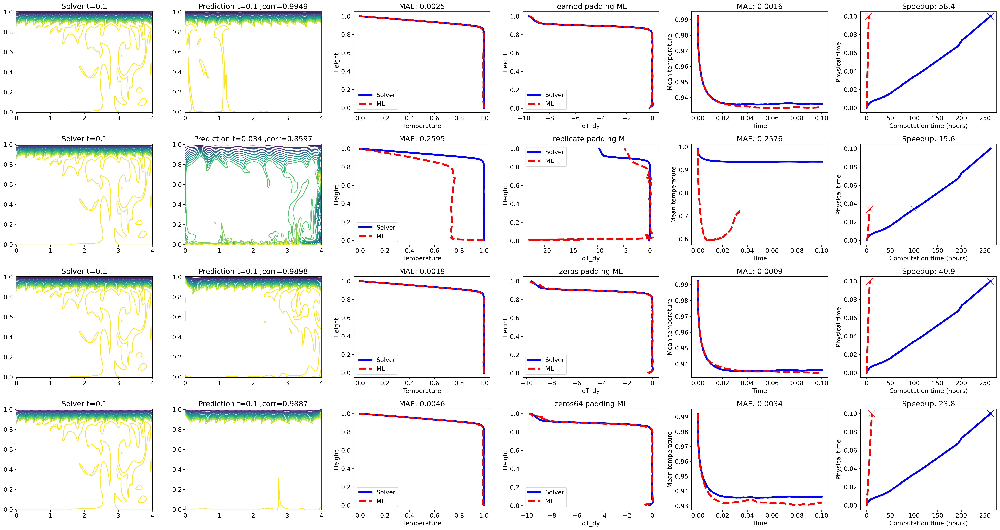

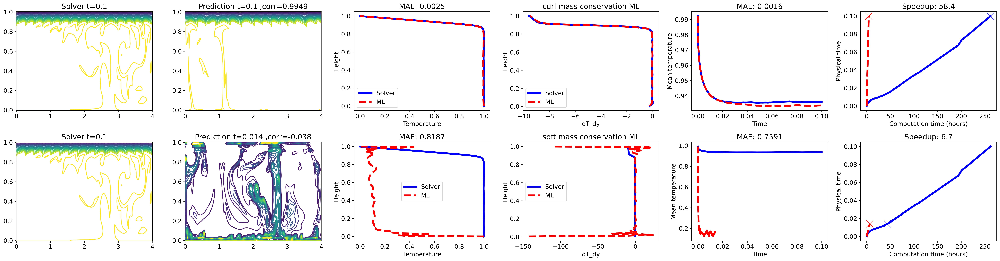

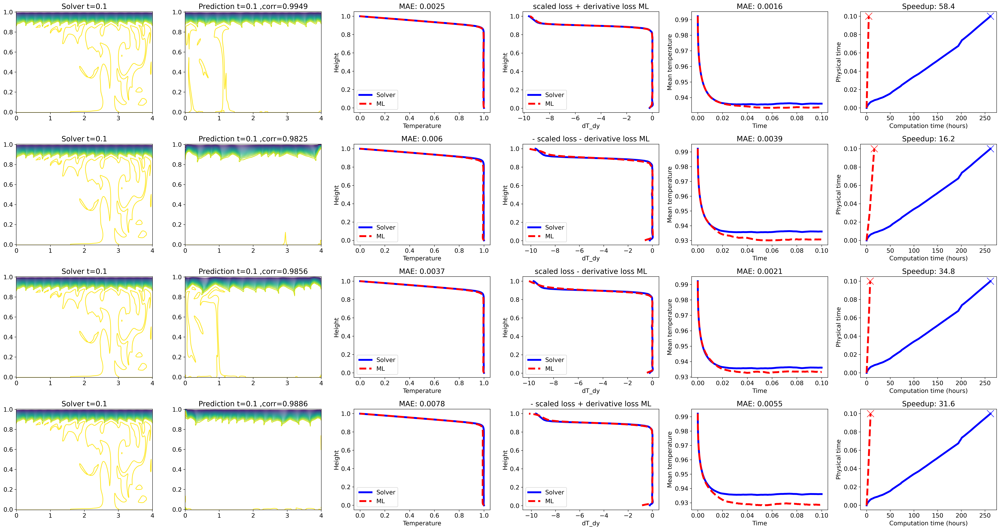

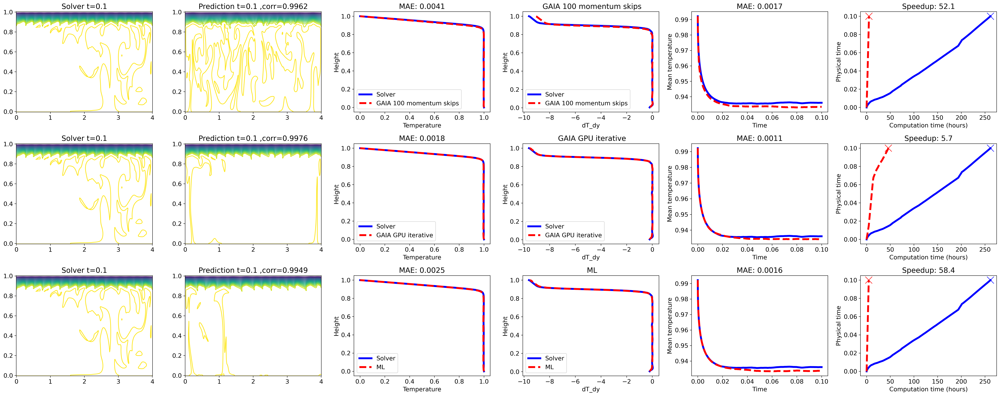

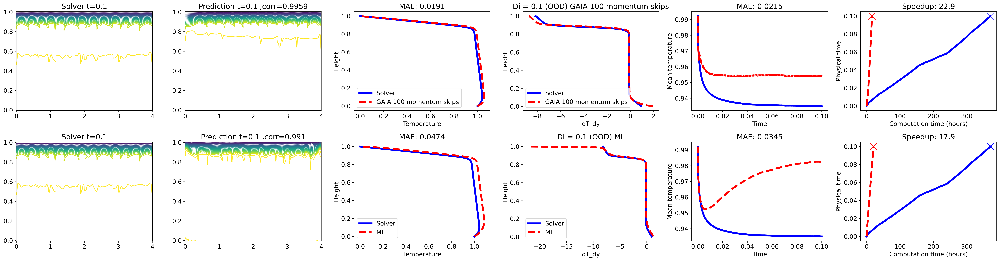

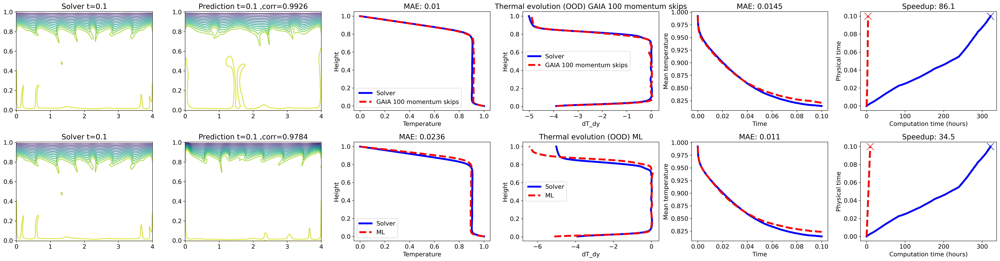

In [6]:
plt.rcParams.update({'font.size': 13})
core_cool = 0
make_gifs = False

# raq, fkt, fkp, Di, start, radioactive_decay, solvers, study
solvers = [["GAIA",      1,   "mumps",     1.0,  "GAIA"], 
           ["GAIA",      100, "mumps",     1.0,   "GAIA 100 momentum skips"], 
           ["GAIA",      1,   "iterative", 0.99, "GAIA GPU iterative"],
           ["ML_STOKES", 1,   "mumps",     1.0,  "ML"]
          ]
          
paras = [
            [0.80523448 , 3.29628E+6 , 6.37660E+0],
            [9.17743012 , 1.79784E+8 , 7.49928E+0],
            [8.75081696 , 1.68605E+9 , 2.88237E+1],
            [0.0 , 1.00E+6 , 1.0000E+0],
            [10.0, 1.00E+10 , 1.0000E+2],
          ]
                                                             
combs = [
            [paras,    [0.0],           ["hot"],                       [0],   [solvers[s] for s in [0,1,3]],  
             ["learned"], ["curl"], [[True, True]], "Different_parameters"],
    
            [paras[2:3],      [0.0],         ["hot"],                       [0],   [solvers[s] for s in [0,3]],  
             ["learned", "replicate", "zeros", "zeros64"], ["curl"], [[True, True]], "Ablation_padding"],
            [paras[2:3],      [0.0],         ["hot"],                       [0],   [solvers[s] for s in [0,3]],  
             ["learned"], ["curl", "mass"], [[True, True]], "Ablation_mass"],
            [paras[2:3],      [0.0],         ["hot"],                       [0],   [solvers[s] for s in [0,3]],  
             ["learned"], ["curl"], [[True, True], 
                                     [False, False],
                                     [True, False],
                                     [False, True],
                                    ], "Ablation_loss_scale"],
            [paras[2:3],      [0.0],         ["hot"],                       [0],   [solvers[s] for s in [0,3]],  
             ["learned","u_spc_t","u_sit_t","u_spc","u_sit"], ["curl"], [[True, True]], "Unets"],
            
            [paras[2:3], [0.0],         ["hot"],                       [0],   solvers,                      
             ["learned"], ["curl"], [[True, True]], "Speedup"],
            [paras[2:3], [0.1], ["hot"],                       [0],   [solvers[s] for s in [0,1,3]], 
             ["learned"], ["curl"], [[True, True]], "EBA"],
            [paras[2:3], [0.0],         ["hot"],                    [1], [solvers[s] for s in [0,1,3]], 
             ["learned"], ["curl"], [[True, True]], "Radioactive_decay"],
            [paras[2:3], [0.0],         ["cold", "linear", "perfect"], [0],   [solvers[s] for s in [0,1,3]], 
             ["learned"], ["curl"], [[True, True]], "Different_starts", ],
            
        ]

results_dir = "/plp_scr2/PLAGeS/CONVNN/GAIA_ML_RUNS/ML_RUNS/"
os.makedirs(results_dir + "gifs", exist_ok=True) 

for comb in combs:
    total_combs = int(len(comb[0])*len(comb[1])*len(comb[2])*len(comb[3])*(len(comb[4])-1)*len(comb[5])*len(comb[6])*len(comb[7]))
    
    fig = plt.figure(figsize=(30,4*total_combs),dpi=320)
    cntr = 1

    os.makedirs(results_dir + "gifs/" + comb[-1], exist_ok=True) 

    for paras_list in comb[0]:
        raq, fkt, fkp = paras_list
        for Di in comb[1]:
            for start in comb[2]:
                for radioactive_decay in comb[3]:
                    
                    t_t, T_t, TS_t, snapshots_t               = get_data(raq, fkt, fkp, 1, "mumps", 1.0, Di, 
                                                                         start, "GAIA", core_cool, radioactive_decay)
                    z_t, Tp_t, dTp_t, modes_t, comp_time_t, r = get_plot_data(snapshots_t, t_t, TS_t, var="T")

                    gif_str = "Q_" + str(np.round(raq,2)) \
                             + "_fkt_" + "{:.2E}".format(Decimal(fkt)) \
                             + "_fkp_" + "{:.2E}".format(Decimal(fkp)) \
                             + "_Di_" + "{:.2E}".format(Decimal(Di)) \
                             + "_" + start
                    if radioactive_decay:
                        gif_str += "_decay"

                    if make_gifs:
                        if not os.path.isfile(results_dir + "gifs/" + gif_str + ".gif"):
                            make_gif(snapshots_t, t_t, results_dir + "gifs/" + gif_str)
                        if not os.path.isfile(results_dir + "gifs/" + comb[-1] + "/" + gif_str + ".gif"):
                            os.symlink(results_dir + "gifs/" + gif_str + ".gif", 
                                       results_dir + "gifs/" + comb[-1] + "/" + gif_str + ".gif")
                    
                    for solver_list in comb[4][1:]:
                        for padding in comb[5]:
                            for mass in comb[6]:
                                for loss_scale, loss_derivative in comb[7]:
                                    
                                    mode, mmskip, solver, urf, solver_str = solver_list
                                    if comb[-1]=="Ablation_padding":
                                        label = padding + " padding"
                                    elif comb[-1]=="Ablation_mass":
                                        label = mass + " mass conservation" if mass == "curl" else "soft mass conservation"
                                    elif comb[-1]=="Ablation_loss_scale":
                                        if loss_scale and loss_derivative:
                                            label = "scaled loss + derivative loss"
                                        elif loss_scale and not loss_derivative:
                                            label = "scaled loss - derivative loss"
                                        elif not loss_scale and loss_derivative:
                                            label = "- scaled loss + derivative loss"
                                        elif not loss_scale and not loss_derivative:
                                            label = "- scaled loss - derivative loss"
                                    elif comb[-1]=="Speedup":
                                        label = ""
                                    elif comb[-1]=="EBA":
                                        label = "Di = " + str(Di)
                                        if Di>0:
                                            label += " (OOD)"
                                    elif comb[-1]=="Radioactive_decay":
                                        label = "Thermal evolution (OOD)" if radioactive_decay else "Steady state" 
                                    elif comb[-1] == "Different_starts":
                                        label = start + " start "
                                        if start != "hot":
                                            label += " (OOD)"
                                    elif comb[-1] == "Different_parameters":
                                        label = r"$ Q $ = " + str(np.round(raq,2)) \
                                              + " " + r"$ \gamma $ = " + "{:.2E}".format(Decimal(fkt)) \
                                              + " " + r"$ \beta $ = " + "{:.2E}".format(Decimal(fkp)) 
                                        if raq<0.12624371 or raq>9.70723344 \
                                        or np.log10(fkt)<6.00352841978384 or np.log10(fkt)>9.888820429862925 \
                                        or np.log10(fkp)<0.005251646002323797 or np.log10(fkp)>1.9927988938926755:
                                            label += " (OOD)"
                                    elif comb[-1] == "Unets":
                                        label = padding
                                
                                    label = label + " " + solver_str
                                    
                                    t, T, TS, snapshots             = get_data(raq, fkt, fkp, mmskip, solver, urf, Di, start,
                                                                               mode, core_cool, radioactive_decay,
                                                                               padding, mass, loss_scale, loss_derivative)
                                    z, Tp, dTp, modes, comp_time, r = get_plot_data(snapshots, t, TS, var="T")

                                    print(label)
                                    print(len(T))
                                    print()
                                    giff_str = gif_str + solver_str.replace(" ", "") + "_p" + padding + "_lsc" + str(loss_scale) + "_m" + mass
                                    if make_gifs:
                                        if not os.path.isfile(results_dir + "gifs/" + giff_str + ".gif"):
                                            make_gif(snapshots, t, results_dir + "gifs/" + giff_str)
                                        if not os.path.isfile(results_dir + "gifs/" + comb[-1] + "/" + giff_str + ".gif"):
                                            os.symlink(results_dir + "gifs/" + giff_str + ".gif", 
                                                       results_dir + "gifs/" + comb[-1] + "/" + giff_str + ".gif")
                                                       
            
                                    if t[-1]>t_t[-1]:
                                        ts_mark_t_ind = -1
                                        ts_mark_t     = comp_time_t[ts_mark_t_ind]
                                        ts_mark_ind   = np.where(t<t_t[-1])[0][-1]
                                        ts_mark       = comp_time[ts_mark_ind]
                                        speedup       = np.round(ts_mark_t/ts_mark, 1) 
                                    else:
                                        ts_mark_ind   = -1
                                        ts_mark       = comp_time[ts_mark_ind]
                                        ts_mark_t_ind = np.where(t_t<t[-1])[0][-1]
                                        ts_mark_t     = comp_time_t[ts_mark_t_ind]
                                        speedup       = np.round(ts_mark_t/ts_mark , 1) 
                                
                                        
                                    ax  = fig.add_subplot(total_combs,6,cntr)
                                    cax = ax.tricontour(snapshots["xcc"][0].flatten(), 
                                                        snapshots["ycc"][0].flatten(), 
                                                        z_t.flatten(),
                                                        levels=np.linspace(0,1,16))
                                    #fig.colorbar(cax)
                                    ax.set_title("Solver t=" + str(np.round(t_t[-1].item(),3)))
                                    cntr += 1
                                
                                    ax  = fig.add_subplot(total_combs,6,cntr)
                                    cax = ax.tricontour(snapshots["xcc"][0].flatten(), 
                                                        snapshots["ycc"][0].flatten(), 
                                                        z.flatten(),
                                                        levels=np.linspace(0,1,16))
                                    #fig.colorbar(cax)
                                    corr = np.round(pearsonr(z.flatten(), z_t.flatten())[0], 4)
                                    ax.set_title("Prediction t=" + str(np.round(t[-1],3)) + " ,corr=" + str(corr))
                                    cntr += 1
                                
                                    ax  = fig.add_subplot(total_combs,6,cntr)
                                    
                                    
                                    ax.plot(Tp_t, r, 'b-', label="Solver", lw=4)
                                    ax.plot(Tp, r, 'r--', label=solver_str, lw=4)
                                    ax.set_xlabel("Temperature")
                                    ax.set_ylabel("Height")
                                    ax.set_title("MAE: " + str(np.round(np.mean(np.abs(Tp_t-Tp)), 4)))
                                    ax.legend()
                                    cntr += 1
                                
                                    ax  = fig.add_subplot(total_combs,6,cntr)
                                    
                                    ax.plot(dTp_t, r[1:], 'b-', label="Solver", lw=4)
                                    ax.plot(dTp, r[1:], 'r--',  label=solver_str, lw=4)
                                    ax.set_xlabel("dT_dy")
                                    ax.set_ylabel("Height")
                                    ax.legend()
                                    ax.set_title(label)
                                    cntr += 1
                                    
                                    ax  = fig.add_subplot(total_combs,6,cntr)
                                    ax.plot(t_t, T_t, 'b-', lw=4)
                                    ax.plot(t, T, 'r--', lw=4)
                                    ax.set_xlabel("Time")
                                    ax.set_ylabel("Mean temperature")
                                    max_ind = int(min([len(T_t), len(T)]))
                                    ax.set_title("MAE: " + str(np.round(np.mean(np.abs(np.asarray(T_t[:max_ind]) - np.asarray(T[:max_ind]))), 4)))
                                    cntr += 1
                                    
                                    #ax  = fig.add_subplot(total_combs,6,cntr)
                                    #ax.plot(modes_t[:32], 'b-', lw=4)
                                    #ax.plot(modes[:32], 'r--', lw=4)
                                    #ax.set_ylabel("Modes")
                                    #cntr += 1
                                
                                    ax  = fig.add_subplot(total_combs,6,cntr)
                                    ax.plot(comp_time_t, t_t[:len(TS_t)], 'b-', lw=4)
                                    ax.plot(comp_time_t[ts_mark_t_ind], t_t[ts_mark_t_ind], 'bx', markersize=15)
                                    ax.plot(comp_time, t[:len(TS)], 'r--', lw=4)
                                    ax.plot(comp_time[ts_mark_ind], t[ts_mark_ind], 'rx', markersize=15)
                                    ax.set_ylabel("Physical time")
                                    ax.set_xlabel("Computation time (hours)")
                                    ax.set_title("Speedup: " + str(speedup))
                                    #ax.set_xscale("log")
                                    #ax.set_yscale("log")
                                    cntr += 1
                        
    plt.tight_layout()
    plt.savefig("/plp_scr2/PLAGeS/CONVNN/GAIA_ML_RUNS/ML_RUNS/" + comb[-1] + ".svg")
    #plt.show()
    #plt.close()

## Alternate NNs (TO DO)
    - different architectures: also train f8, r4
    - maybe different number of train simulations 
    - faster training or advect from earlier epochs 
    - time learning baseline (2 unets) 

## Ablations 
    - mass
    - learned padding
    - loss scale
    
## Generalization
    - EBA (Di=0.0,0.1,0.5)
    - extrapolate parameters
    - different restarts 
         cold
         hot
         linear
         perfect
    - radioactive decay

## Speedups
    - GAIA normal
    - GAIA mmsolverskip=50
    - GAIA cuda iterative
    - stokes NN